### Connect Drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## IMPORTING LIBRARIES

In [ ]:
import numpy as np
import pandas as pd
import os
import shutil
import matplotlib.pyplot as plt
import numpy as np

In [ ]:
output_dir = "/content/combined_files"

# Clear the contents of the output directory
shutil.rmtree(output_dir, ignore_errors=True)
os.makedirs(output_dir, exist_ok=True)

print(f"Contents of {output_dir} cleared.")


Contents of /content/combined_files cleared.


## Create combined files for each speaker

In [ ]:
import librosa
import soundfile as sf

# Path to the dataset
dataset_path = "/content/drive/MyDrive/dataset segments"

# Output directory to save the combined files
output_dir = "/content/combined_files"

# Create the output directory if it doesn't exist
os.makedirs(output_dir, exist_ok=True)

# List of speaker folders
speaker_folders = [
    "ahmed_tarek",
    "khaled_alsayed",
    "mohamed_massoud",
    "omar_esmat",
    "shehab_mohamed"
]

# Number of files to combine for each speaker
num_files_to_combine = 70

# Iterate over each speaker's folder
for speaker_folder in speaker_folders:
    speaker_folder_path = os.path.join(dataset_path, speaker_folder)

    # List the first num_files_to_combine WAV files in the speaker's folder
    wav_files = [f"segment_{i}.wav" for i in range(1, num_files_to_combine + 1)]

    # Combine all WAV files into a single long file
    combined_audio = []
    for wav_file in wav_files:
        wav_file_path = os.path.join(speaker_folder_path, wav_file)
        audio, sr = librosa.load(wav_file_path, sr=None)
        combined_audio.extend(audio)

    # Save the combined audio file
    output_file_path = os.path.join(output_dir, f"{speaker_folder}_combined.wav")
    sf.write(output_file_path, combined_audio, sr)

print("Combination complete. Combined files saved in:", output_dir)

Combination complete. Combined files saved in: /content/combined_files


IPython is an interactive command-line shell for Python. It provides an enhanced interactive environment for Python programming and is particularly popular among data scientists, researchers, and engineers working in scientific computing, data analysis, and machine learning.

In [ ]:
from IPython.display import display, Audio

# Function to play audio file
def play_audio(audio_path):
    display(Audio(filename=audio_path))

# Play a specific combined audio file
speaker_folder = "omar_esmat_combined"
audio_path = os.path.join(output_dir, f"{speaker_folder}.wav")
print(f"Click the play button to listen: {audio_path}")
play_audio(audio_path)


Click the play button to listen: /content/combined_files/omar_esmat_combined.wav


In [ ]:
# Play a specific combined audio file
speaker_folder = "khaled_alsayed_combined"
audio_path = os.path.join(output_dir, f"{speaker_folder}.wav")
print(f"Click the play button to listen: {audio_path}")
play_audio(audio_path)

Click the play button to listen: /content/combined_files/khaled_alsayed_combined.wav


In [ ]:
# Play a specific combined audio file
speaker_folder = "mohamed_massoud_combined"
audio_path = os.path.join(output_dir, f"{speaker_folder}.wav")
print(f"Click the play button to listen: {audio_path}")
play_audio(audio_path)

Click the play button to listen: /content/combined_files/mohamed_massoud_combined.wav


## DATA VISUALIZATIONS

<ipython-input-13-b0ed0a9f564e>:19: UserWarning: amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(np.abs(S)) instead.
  D = librosa.amplitude_to_db(librosa.stft(y), ref=np.max)


[[-5.07676971e+02 -4.94246216e+02 -5.07668213e+02 ... -4.64358612e+02
  -4.55469391e+02 -4.60924408e+02]
 [ 9.59156647e+01  1.05649384e+02  9.47004471e+01 ...  1.37380783e+02
   1.43425476e+02  1.39964417e+02]
 [ 1.48935595e+01  1.23767700e+01  1.06635618e+01 ...  3.11332951e+01
   2.91142769e+01  3.13752041e+01]
 ...
 [ 3.25331020e+00 -2.83394158e-01 -2.69169188e+00 ...  2.96802139e+00
  -9.77014542e-01  3.34764540e-01]
 [-1.28375578e+00 -3.10690188e+00  5.13251066e-01 ... -1.68400459e+01
  -1.83499260e+01 -1.24042015e+01]
 [-1.30763750e+01 -1.11698151e+01 -1.16851354e+00 ... -1.57532177e+01
  -1.80579433e+01 -1.22844458e+01]]


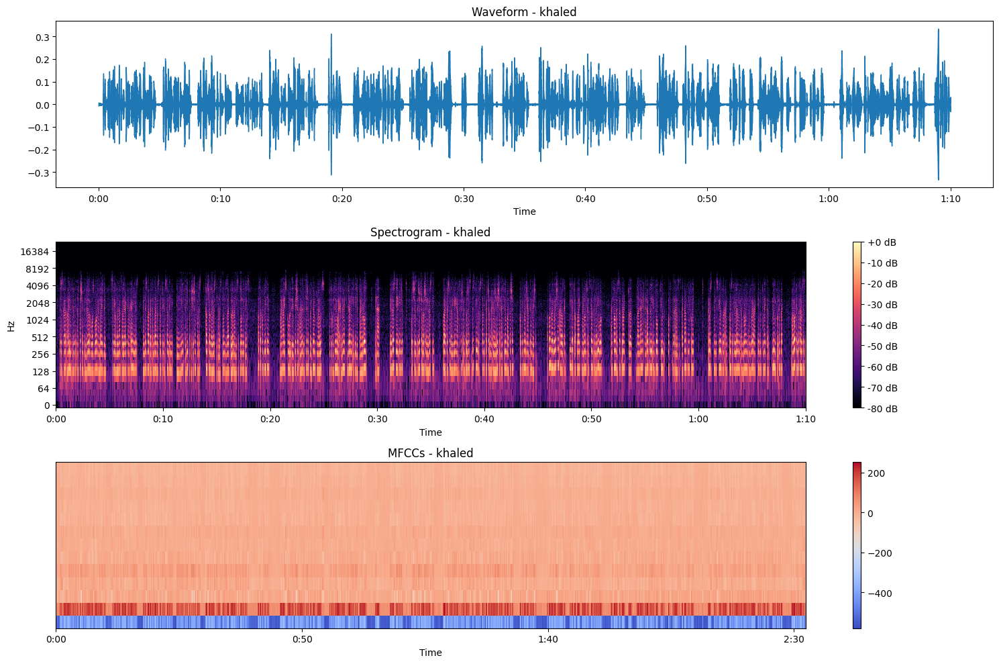

[[-3.3456296e+02 -3.1257831e+02 -3.1612704e+02 ... -3.2089651e+02
  -3.1968045e+02 -3.1859766e+02]
 [ 1.1421828e+02  1.2532274e+02  1.2725217e+02 ...  1.5951846e+02
   1.4994945e+02  1.4130971e+02]
 [-2.3245232e+01 -2.7878605e+01 -2.4828167e+01 ...  2.1237591e+01
   6.3052263e+00 -6.4007101e+00]
 ...
 [ 2.2320411e+00 -3.2054048e+00 -6.8500218e+00 ... -3.2397499e+00
  -2.7816111e-01 -2.0562754e+00]
 [-3.9854667e+00 -5.3494167e+00 -3.8200281e+00 ... -8.4040966e+00
   8.9341855e-01 -6.5906847e-01]
 [ 7.7408895e+00  3.8968577e+00 -1.6919014e+00 ... -5.9374623e+00
   7.8752184e+00  1.0512226e+01]]


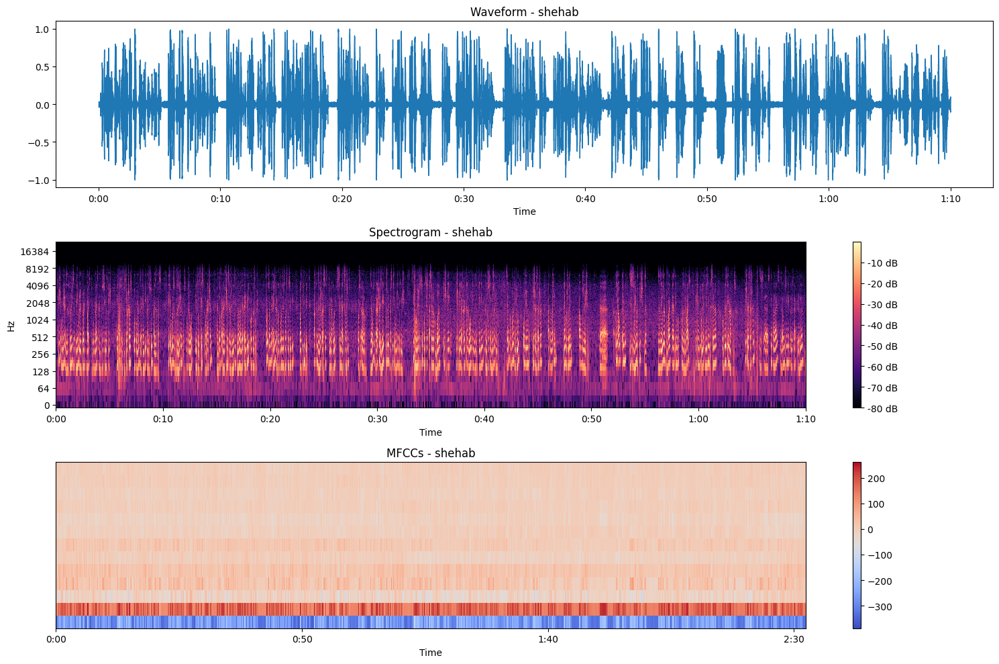

In [ ]:
import librosa.display

# Function to plot the waveform, spectrogram, and MFCCs
def plot_audio_features(audio_path):
    # Load audio file
    y, sr = librosa.load(audio_path, sr=None)

    # Extract speaker name from the file path
    speaker_name = os.path.basename(audio_path).split('_')[0]

    # Plot the waveform
    plt.figure(figsize=(15, 10))
    plt.subplot(3, 1, 1)
    librosa.display.waveshow(y, sr=sr)
    plt.title(f'Waveform - {speaker_name}')

    # Plot the spectrogram
    plt.subplot(3, 1, 2)
    D = librosa.amplitude_to_db(librosa.stft(y), ref=np.max)
    librosa.display.specshow(D, sr=sr, x_axis='time', y_axis='log')
    plt.colorbar(format='%+2.0f dB')
    plt.title(f'Spectrogram - {speaker_name}')

    # Plot the MFCCs
    plt.subplot(3, 1, 3)
    mfccs = librosa.feature.mfcc(y=y, sr=sr, n_mfcc=13)
    librosa.display.specshow(mfccs, x_axis='time')
    plt.colorbar()
    plt.title(f'MFCCs - {speaker_name}')
    print(mfccs)

    plt.tight_layout()
    plt.show()

# Paths to the combined audio files
audio_paths = [
    '/content/combined_files/khaled_alsayed_combined.wav',
    '/content/combined_files/shehab_mohamed_combined.wav'
]

# Plot features for each audio file
for audio_path in audio_paths:
    plot_audio_features(audio_path)


## FEATURE EXTRACTION

In [ ]:
import tensorflow as tf
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
import tensorflow as tf
from sklearn.model_selection import train_test_split
import os
import numpy as np
import librosa
from tensorflow.keras.preprocessing.sequence import pad_sequences

# Set the parent directory for speaker folders
parent_dir = "/content/drive/MyDrive/dataset segments"

# List of speaker folders
speaker_folders = [
  "ahmed_tarek",
    "khaled_alsayed",
    "mohamed_massoud",
    "omar_esmat",
    "shehab_mohamed"
]




# Function definition to extract features

from tensorflow.keras.preprocessing.sequence import pad_sequences
def extract_features(parent_dir, speaker_folders, max_len=None):
    features = []
    labels = []

    for i, speaker_folder in enumerate(speaker_folders):
        speaker_folder_path = os.path.join(parent_dir, speaker_folder)

        for filename in os.listdir(speaker_folder_path):
            if filename.endswith(".wav"):
                file_path = os.path.join(speaker_folder_path, filename)
                audio, sr = librosa.load(file_path, sr=None, duration=1)
                mfccs = librosa.feature.mfcc(y=audio, sr=sr, n_mfcc=12)


                mfccs = pad_sequences([mfccs.T], maxlen=max_len, padding='post')[0]
                mfccs = StandardScaler().fit_transform(mfccs)

                features.append(mfccs)
                labels.append(i)

    return np.array(features), np.array(labels)

# Extract features and labels
max_len = 100  # You can set the maximum length as per your requirement
X, y = extract_features(parent_dir, speaker_folders, max_len=max_len)

In [ ]:
# Print the first few features
for feature in X[:1]:
    print(feature)

[[-0.51561964  0.51628656  0.13046908 ...  1.18816805  0.23819128
   0.50891336]
 [-0.24919544  0.58874783 -0.70587119 ...  1.35937383 -0.54921792
  -0.5513228 ]
 [-0.24031463  0.53440187 -0.95677327 ...  1.01696228 -1.13977482
  -1.08144089]
 ...
 [ 2.37952338 -2.54520215  1.38497949 ... -0.01027235 -0.74607022
   0.50891336]
 [ 2.37952338 -2.54520215  1.38497949 ... -0.01027235 -0.74607022
   0.50891336]
 [ 2.37952338 -2.54520215  1.38497949 ... -0.01027235 -0.74607022
   0.50891336]]


In [ ]:
print(tf.config.list_physical_devices('GPU'))

[]


## MODEL SET UP - TRAIN/TEST SPLIT and EVALUATION

Splitting the data into 70% train and the remaining will be split equally into validation and test datasets.

In [ ]:
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.preprocessing import LabelEncoder

# Encode labels with explicit classes
label_encoder = LabelEncoder()
y = label_encoder.fit_transform(y)
label_encoder.classes_ = np.array(speaker_folders)

# Split the data into training, validation, and test sets
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.3, random_state=42)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)

# Print the shapes of training and validation data
print("Training Data Shape:", X_train.shape)
print("Validation Data Shape:", X_val.shape)

Training Data Shape: (845, 100, 12)
Validation Data Shape: (181, 100, 12)


## TRAINING

We are also using early stopping to avoid extra runtime and overfitting on the training dataset. Running for 20 Epochs with adam optimizer for compilation.

In [ ]:
# Define the RNN model
model = tf.keras.Sequential([
    tf.keras.layers.LSTM(128, input_shape=(X_train.shape[1], X_train.shape[2])),
    tf.keras.layers.Dense(64, activation='relu'),
    tf.keras.layers.Dense(len(speaker_folders), activation='softmax')
])

# Compile the model
model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Define the EarlyStopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=2, restore_best_weights=True)

# Train the model with EarlyStopping
history = model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=20, batch_size=32, callbacks=[early_stopping])

# Check if EarlyStopping triggered
if early_stopping.stopped_epoch > 0:
    print("Early stopping triggered at epoch", early_stopping.stopped_epoch + 1)
else:
    print("Training completed without early stopping")

Epoch 1/20
27/27 [==============================] - 6s 138ms/step - loss: 0.9192 - accuracy: 0.7183 - val_loss: 0.3661 - val_accuracy: 0.9006
Epoch 2/20
27/27 [==============================] - 3s 115ms/step - loss: 0.2370 - accuracy: 0.9278 - val_loss: 0.1032 - val_accuracy: 0.9669
Epoch 3/20
27/27 [==============================] - 5s 194ms/step - loss: 0.0846 - accuracy: 0.9728 - val_loss: 0.0700 - val_accuracy: 0.9669
Epoch 4/20
27/27 [==============================] - 4s 140ms/step - loss: 0.0433 - accuracy: 0.9870 - val_loss: 0.0573 - val_accuracy: 0.9834
Epoch 5/20
27/27 [==============================] - 3s 117ms/step - loss: 0.0359 - accuracy: 0.9870 - val_loss: 0.0138 - val_accuracy: 1.0000
Epoch 6/20
27/27 [==============================] - 3s 117ms/step - loss: 0.0127 - accuracy: 0.9988 - val_loss: 0.0139 - val_accuracy: 1.0000
Epoch 7/20
27/27 [==============================] - 5s 201ms/step - loss: 0.0068 - accuracy: 1.0000 - val_loss: 0.0085 - val_accuracy: 1.0000
Epoch 

### Plot training vs validation loss


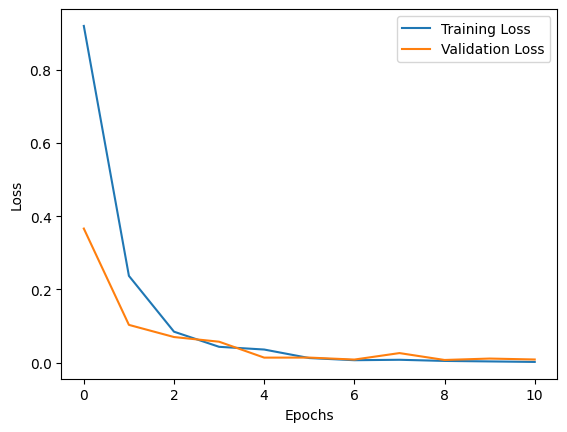

In [ ]:
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

### Plot training vs validation accuracy


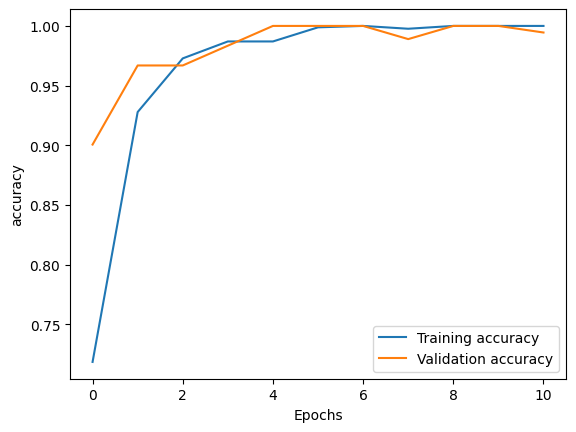

In [ ]:
plt.plot(history.history['accuracy'], label='Training accuracy')
plt.plot(history.history['val_accuracy'], label='Validation accuracy')
plt.xlabel('Epochs')
plt.ylabel('accuracy')
plt.legend()
plt.show()

## EVALUATION

6/6 [==============================] - 1s 79ms/step
Test Evaluation Accuracy: 0.9835164835164835
Weighted F1 Score: 0.9834513432528321


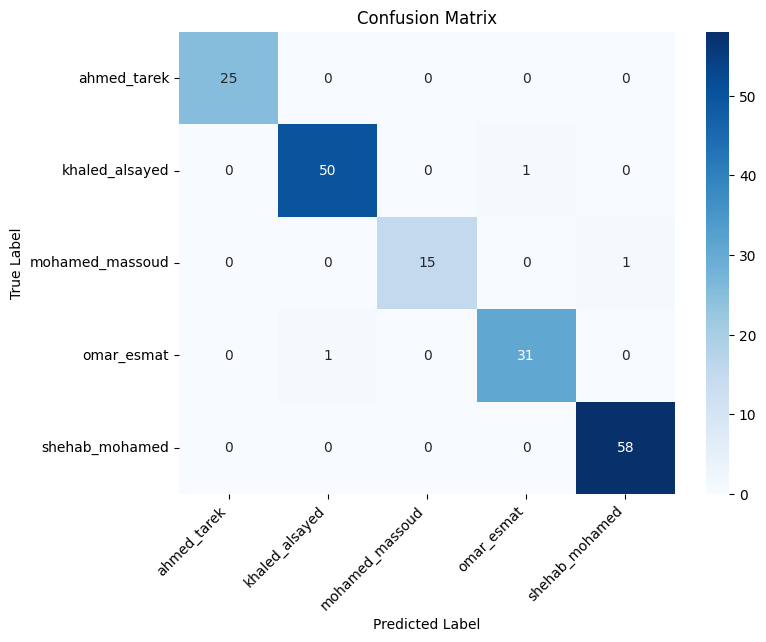

In [ ]:
import seaborn as sns
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score, f1_score

# Evaluate the model on the test set
y_pred_probabilities = model.predict(X_test)
y_pred = np.argmax(y_pred_probabilities, axis=1)

# Decode labels back to original format
y_test_decoded = label_encoder.inverse_transform(y_test)
y_pred_decoded = label_encoder.inverse_transform(y_pred)

# Create a confusion matrix
conf_matrix = confusion_matrix(y_test_decoded, y_pred_decoded, labels=speaker_folders)

# Calculate accuracy
accuracy = accuracy_score(y_test_decoded, y_pred_decoded)
print(f"Test Evaluation Accuracy: {accuracy}")

# Calculate F1 score
f1 = f1_score(y_test_decoded, y_pred_decoded, labels=speaker_folders, average='weighted')
print(f"Weighted F1 Score: {f1}")

# Plot the confusion matrix
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=speaker_folders, yticklabels=speaker_folders)

# Rotate x-axis labels by 45 degrees
plt.xticks(rotation=45, ha="right")

plt.title("Confusion Matrix")
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.show()

In [ ]:
from sklearn.metrics import classification_report

# Print classification report
print(classification_report(y_test_decoded, y_pred_decoded, target_names=speaker_folders))

                 precision    recall  f1-score   support

    ahmed_tarek       1.00      1.00      1.00        25
 khaled_alsayed       0.98      0.98      0.98        51
mohamed_massoud       1.00      0.94      0.97        16
     omar_esmat       0.97      0.97      0.97        32
 shehab_mohamed       0.98      1.00      0.99        58

       accuracy                           0.98       182
      macro avg       0.99      0.98      0.98       182
   weighted avg       0.98      0.98      0.98       182



In [ ]:
def predict_speaker(audio_path):
    # Extract features from the audio file
    audio, sr = librosa.load(audio_path, sr=None, duration=1)
    mfccs = librosa.feature.mfcc(y=audio, sr=sr, n_mfcc=12)
    mfccs = pad_sequences([mfccs.T], maxlen=max_len, padding='post')[0]
    mfccs = StandardScaler().fit_transform(mfccs)
    features = np.array([mfccs])

    # Make a prediction
    prediction_probabilities = model.predict(features)
    predicted_label_index = np.argmax(prediction_probabilities)
    predicted_speaker = label_encoder.classes_[predicted_label_index]

    return predicted_speaker

# Example usage:

audio_path = "/content/combined_files/omar_esmat_combined.wav"
predicted_speaker = predict_speaker(audio_path)
print("Predicted Speaker:", predicted_speaker)

1/1 [==============================] - 0s 56ms/step
Predicted Speaker: omar_esmat
